In [1]:

import numpy as np
import xarray as xr
from matplotlib import pyplot as plt
import pydmd


import pickle as pkl
from utils import *

import pandas as pd
import seaborn as sns

import cartopy.crs as ccrs

import imageio.v2 as imageio

import cartopy.feature as cfeature

## Eigenvalues

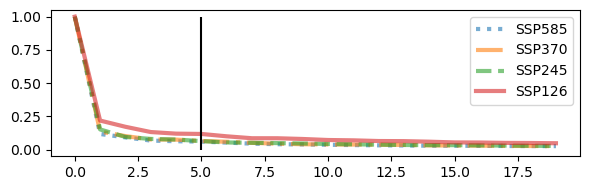

In [36]:
linestyles = ['dotted', 'dashdot', 'dashed', 'solid']

plt.figure(figsize = (6,2))


lag = 30
forced_means = {}
for i, scenario in enumerate([585,370,245,126]):
    xr_train_clim = xr.open_dataset('./data/train_val/outputs_historical.nc').mean(dim='member')
    xr_test_clim = xr.open_dataset(f'./data/train_val/outputs_ssp{scenario}.nc').mean(dim='member')

    tas_all = xr.concat([xr_train_clim, xr_test_clim], dim = 'time').tas.values
    times = xr.concat([xr_train_clim, xr_test_clim], dim = 'time').time
    ntime, nlat, nlong = tas_all.shape
    tas_data = tas_all.reshape(ntime, -1)[lag-1:,:]

    X = tas_data.T[:, 1:]

    U, s, V = np.linalg.svd(X, full_matrices=False)
    
    plt.plot(s[:20]/s.max(), linestyle = linestyles[i], alpha = .6, lw = 3, label = f'SSP{scenario}')

# plt.yscale('log')

plt.vlines(5, 0,1, color = 'k')
plt.legend()

plt.tight_layout()
plt.savefig('./plots/sing_vals.pdf', bbox_inches = 'tight')

In [2]:
xr_train_clim = xr.open_dataset('./data/train_val/outputs_historical.nc').mean(dim='member')
xr_test_clim = xr.open_dataset(f'./data/train_val/outputs_ssp126.nc').mean(dim='member')

tas_all = xr.concat([xr_train_clim, xr_test_clim], dim = 'time').tas
lat_data = tas_all.lat
lon_data = tas_all.lon


# a small change to plotting function
plotmap = lambda mode, ax, amax: make_plot(mode, lat_data, lon_data, fig, ax, 0,
                                           min_val=-amax, max_val=amax, colorbar=True)

                                           # a small change to plotting function
plotmap1 = lambda mode, ax, amax: make_plot(mode, lat_data, lon_data, fig, ax, 0,
                                           min_val=-amax, max_val=amax, colorbar=False)


## Two temperature plots

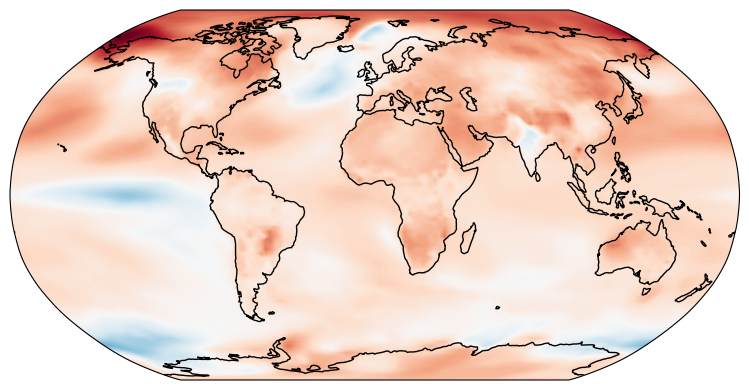

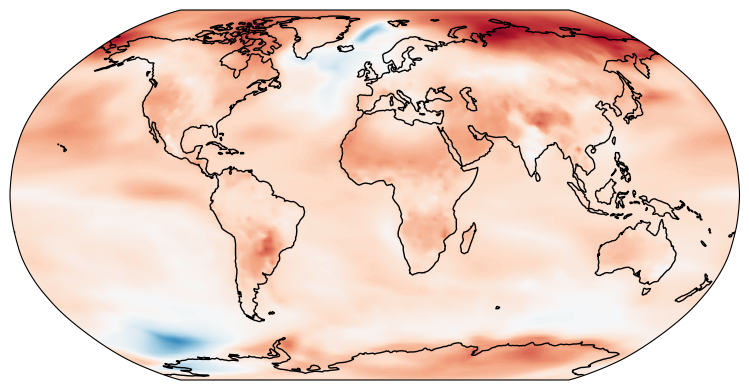

In [16]:

scenario = 126

xr_train_clim = xr.open_dataset('./data/train_val/outputs_historical.nc').mean(dim='member')
xr_test_clim = xr.open_dataset(f'./data/train_val/outputs_ssp{scenario}.nc').mean(dim='member')

xr_test_clim = xr.concat([xr_train_clim, xr_test_clim], dim = 'time')
times = xr_test_clim.time


max_val = np.max([-xr_test_clim.tas.values[[180,181]].min(), xr_test_clim.tas.values[[180,181]].max()])
min_val = -max_val

for i, year in enumerate([2030,2031]):
    fig, ax = plt.subplots(1, 1, figsize=(18, 4), subplot_kw={'projection': ccrs.Robinson()})
    idx = np.where(times.values == year)

    X = xr_test_clim['tas'].values[idx,:,:].flatten()

    pixel_vals = np.real(X).reshape(96, 144)

    field = xr.DataArray(data = pixel_vals,
                         dims = ('lat', 'lon'),
                         coords = {'lat': lat_data,
                                        'lon': lon_data})

    cmap = 'RdBu_r'

    wrap_data, wrap_lon = add_cyclic_point(field.values,
                                            coord=field.lon,
                                            axis=field.dims.index('lon'))

    levels = np.linspace(min_val, max_val, 150)

    cx = ax.contourf(wrap_lon,
                        field.lat,
                        wrap_data,
                        levels=levels,
                        cmap=cmap,
                        transform=ccrs.PlateCarree())
    ax.set_global()
    ax.coastlines()

    plt.tight_layout()

    plt.savefig(f'plots/{year}_TAS.png', bbox_inches='tight')
    

In [13]:
np.where(times.values == 2001)

(array([150]),)

In [26]:
times[151:181]

<xarray.DataArray 'time' (time: 30)>
array([2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012,
       2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024,
       2025, 2026, 2027, 2028, 2029, 2030])
Coordinates:
  * time      (time) int64 2001 2002 2003 2004 2005 ... 2026 2027 2028 2029 2030
    quantile  float64 0.9

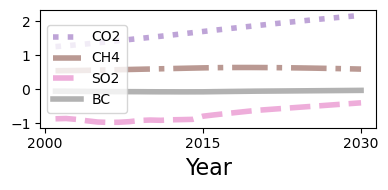

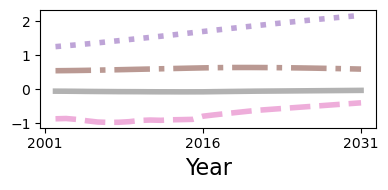

In [27]:
plt.figure(figsize = (4,2))
ssp = 126
forcing_data = np.load(f'./data/forcings/historical+ssp{ssp}_forcing.npy').T[151:181]


colors = ['tab:purple', 'tab:brown', 'tab:pink', 'tab:grey']
linestyles = ['dotted', 'dashdot', 'dashed', 'solid']
for i, agent in zip([0,1,2,3],['CO2','CH4','SO2','BC']):

    zs = forcing_data[:,i]
    plt.plot(times[151:181], zs, lw = 4, label = agent, color = colors[i], linestyle = linestyles[i], alpha = .6)


plt.xlabel('Year', size = '16')
plt.xticks([2000,2015,2030])
# plt.ylabel('Radiative forcing')
plt.legend(loc='center left')
plt.tight_layout()
plt.savefig(f'./plots/radiative_forcing_ssp{ssp}2030.png')


plt.figure(figsize = (4,2))
colors = ['tab:purple', 'tab:brown', 'tab:pink', 'tab:grey']
linestyles = ['dotted', 'dashdot', 'dashed', 'solid']
for i, agent in zip([0,1,2,3],['CO2','CH4','SO2','BC']):

    zs = forcing_data[:,i]
    plt.plot(times[152:182], zs, lw = 4, label = agent, color = colors[i], linestyle = linestyles[i], alpha = .6)


plt.xlabel('Year', size = '16')
plt.xticks([2001,2016,2031])
# plt.ylabel('Radiative forcing')
plt.tight_layout()
plt.savefig(f'./plots/radiative_forcing_ssp{ssp}2031.png')

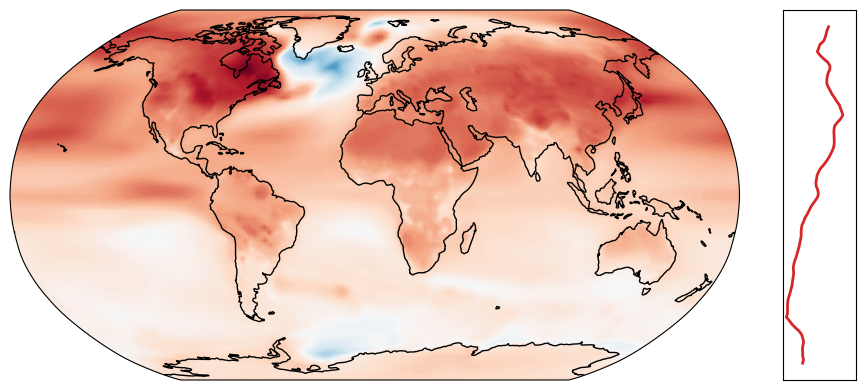

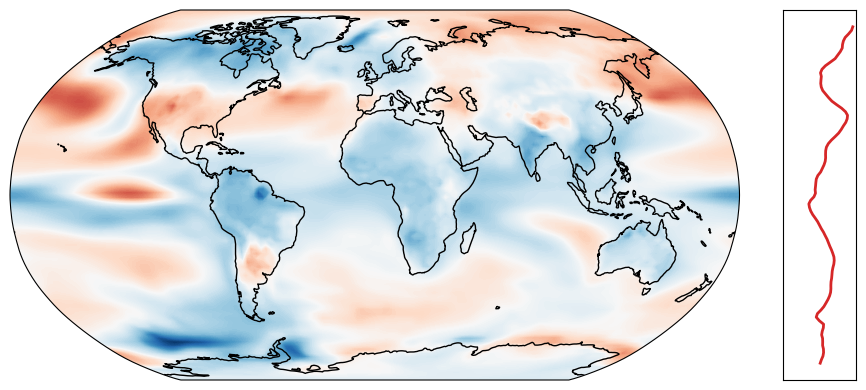

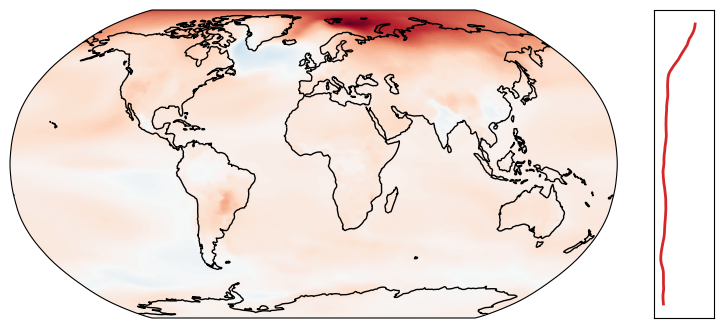

In [5]:
ssp = 126

my_dmdc = {}
with open(f'./models/DMDc-hankelforcing/tas{ssp}.pkl', 'rb') as f:
    my_dmdc[ssp] = pkl.load(f)

xr_train_clim = xr.open_dataset('./data/train_val/outputs_historical.nc').mean(dim='member')
xr_test_clim = xr.open_dataset(f'./data/train_val/outputs_ssp126.nc').mean(dim='member')


tas_all = xr.concat([xr_train_clim, xr_test_clim], dim = 'time').tas
lat_data = tas_all.lat
lon_data = tas_all.lon


########
#warming

mode = [0,1]
X0 = get_real(my_dmdc, ssp, mode)

fig, ax = plt.subplots(1, 1, figsize=(9,4), 
                       subplot_kw={'projection': ccrs.Robinson()})

caxs = []
caxs.append(ax.inset_axes((1.06, 0, 0.1, 1)))

j = 0
caxs[j].plot(np.mean(np.real(X0).reshape(96, 144), axis = 1), lat_data, color = 'tab:red', lw = 2)
caxs[j].set_yticks([])
caxs[j].set_xlim([0,.35])
caxs[j].set_xticks([])
# caxs[j].set_xlabel('Mean',fontsize=12)
# caxs[j].tick_params(axis='x',labelsize=12)

X0 = get_real(my_dmdc, ssp, mode)
amax = np.max([X0.max(), -X0.min()])
plotmap1(X0, ax, amax)
# ax.set_title(f"SSP{ssp}",fontdict = {'fontsize':18})

plt.tight_layout()
plt.savefig(f'plots/warming_ssp{ssp}.png', bbox_inches = 'tight')


########
#enso

mode = [2,3]
X0 = get_real(my_dmdc, ssp, mode)

fig, ax = plt.subplots(1, 1, figsize=(9,4), 
                       subplot_kw={'projection': ccrs.Robinson()})

caxs = []
caxs.append(ax.inset_axes((1.06, 0, 0.1, 1)))

j = 0
caxs[j].plot(np.mean(np.real(X0).reshape(96, 144), axis = 1), lat_data, color = 'tab:red', lw = 2)
caxs[j].set_yticks([])
caxs[j].set_xlim([-.25,.12])
caxs[j].set_xticks([])
# caxs[j].set_xticks([-.2,.1])
# caxs[j].set_xlabel('Mean',fontsize=12)
# caxs[j].tick_params(axis='x',labelsize=12)

X0 = get_real(my_dmdc, ssp, mode)
amax = np.max([X0.max(), -X0.min()])
plotmap1(X0, ax, amax)
# ax.set_title(f"SSP{ssp}",fontdict = {'fontsize':18})

plt.tight_layout()
plt.savefig(f'plots/enso_ssp{ssp}.png', bbox_inches = 'tight')

########
#emissions
lag = 30
fig, ax = plt.subplots(1, 1, figsize=(9,4), 
                       subplot_kw={'projection': ccrs.Robinson()})

caxs = []
caxs.append(ax.inset_axes((1.06, 0, 0.1, 1)))

forcing_data = np.load(f'./data/forcings/historical+ssp{ssp}_forcing.npy').T
control_data = TDE_wravel(forcing_data, lag = lag)
control_data = control_data[-50:,:].T # remove last year
    
X_all = np.real(np.mean(my_dmdc[ssp].B @ control_data, axis = 1))
amax = X_all.max()
plotmap1(X_all, ax, amax)
# ax.set_title(f"SSP{ssp}",
#                 fontdict = {'fontsize':18})

j=0
caxs[j].plot(np.mean(X_all.reshape(96, 144), axis = 1), lat_data, color = 'tab:red', lw = 2)
caxs[j].set_yticks([])
caxs[j].set_xlim([-.1,amax])
caxs[j].set_xticks([])
# caxs[j].set_xlabel('Mean',fontsize=12)
# caxs[j].tick_params(axis='x',labelsize=12)
plt.savefig(f'plots/emissions_ssp{ssp}.png', bbox_inches = 'tight')


In [6]:
len(times)

251

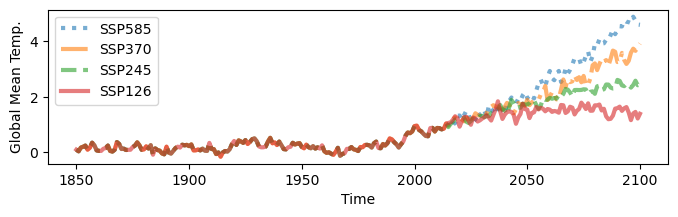

In [3]:
plt.figure(figsize = (8,2))
linestyles = ['dotted', 'dashdot', 'dashed', 'solid']
for i,scenario in enumerate([585, 370, 245, 126]):
    xr_train_clim = xr.open_dataset('./data/train_val/outputs_historical.nc').mean(dim='member')
    xr_test_clim = xr.open_dataset(f'./data/train_val/outputs_ssp{scenario}.nc').mean(dim='member')

    tas_all = xr.concat([xr_train_clim, xr_test_clim], dim = 'time').tas
    times = tas_all.time

    plt.plot(times, np.mean(np.mean(tas_all.values, axis = 1),axis = 1), label = f'SSP{scenario}', alpha = .6, lw = 3, linestyle= linestyles[i])
    plt.legend()
    plt.xlabel('Time')
    plt.ylabel('Global Mean Temp.')
        
plt.savefig('plots/climate_bench.pdf')
    

In [6]:

regions = ['NorthAmerica', 'SouthAmerica', 'NorthernAfrica', 'SouthernAfrica',
           'Europe','Russia','SouthAsia','EastAsia','Oceania']


# use this code https://github.com/lm2612/GPRegression/blob/master/RegionLatitudes.py
RegionLonsLats = {'NorthAmerica':(230.,300.,10.,66.),
                'SouthAmerica':(360.-80.,360.-35.,-50.,10.),
                'NorthernAfrica':(340.,50.,10.,35.), # would prefer this to start at 5 deg?
                'SouthernAfrica':(10.,50.,-50.,10.),
                'Europe':(340.,50.,35.,66.),
                'Russia':(50.,  100. ,35.,66.),
                'SouthAsia':(50.,100.,0.,35.),
                'Oceania':(100.,180. ,-50., 10.),
                'EastAsia':(100.,145.,10.,66. ),
                'Oceania':(100.,180. ,-50., 10.)
        }

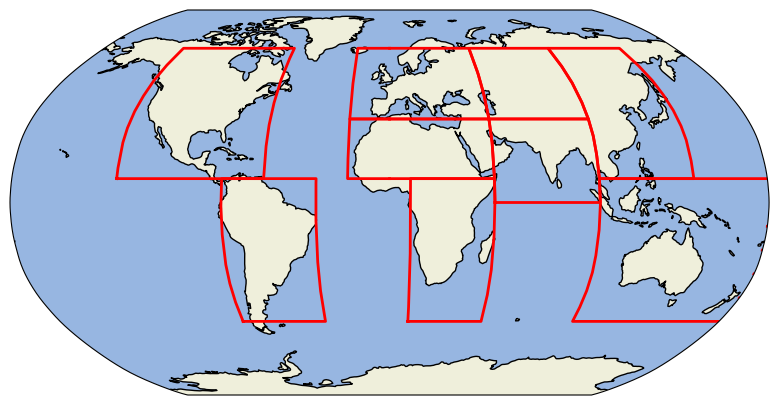

In [7]:

# Create a new figure with a specific projection
fig, ax = plt.subplots(figsize=(10, 5), subplot_kw={'projection':  ccrs.Robinson()})

# Add map features
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)

for region_id in regions:

        # Define the coordinates of the bounding box
        min_lon, max_lon, min_lat, max_lat = RegionLonsLats[region_id]

        # Plot the bounding box
        if min_lon > max_lon:
                # Split the box into two parts
                ax.plot([360, min_lon, min_lon, min_lon, 360],
                        [max_lat, max_lat, min_lat, min_lat, min_lat],
                        transform=ccrs.PlateCarree(),
                        color='red', linewidth=2)
                ax.plot([0, max_lon, max_lon, 0],
                        [min_lat, min_lat, max_lat, max_lat],
                        transform=ccrs.PlateCarree(),
                        color='red', linewidth=2)
        elif min_lon == max_lon-360:
                ax.plot([min_lon, max_lon],
                        [min_lat, min_lat],
                        color='red', linewidth=2, transform=ccrs.PlateCarree())
        else: 
                ax.plot([min_lon, max_lon, max_lon, min_lon, min_lon],
                        [min_lat, min_lat, max_lat, max_lat, min_lat],
                        color='red', linewidth=2, transform=ccrs.PlateCarree())


ax.set_global()

plt.savefig('plots/regions.pdf')


/var/folders/5m/bv9phk393431tllslwr8yzyw0000gp/T/ipykernel_48774/2313639785.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 1, figsize=(7, 5), subplot_kw={'projection': ccrs.Robinson()})


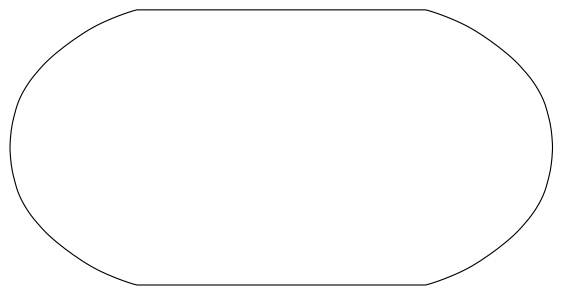

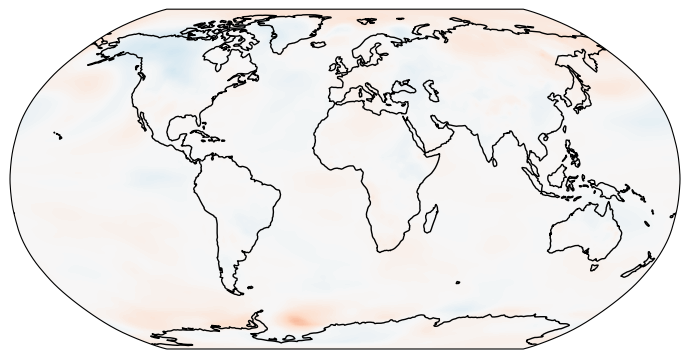

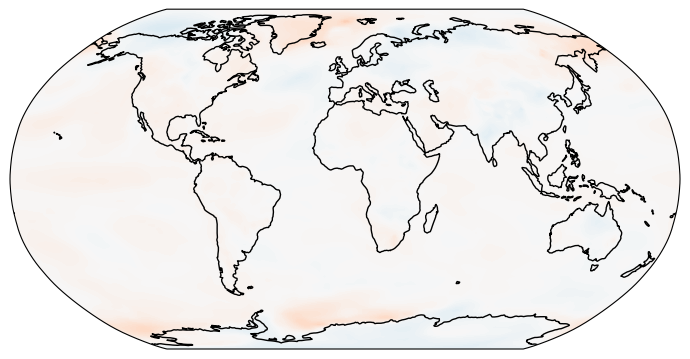

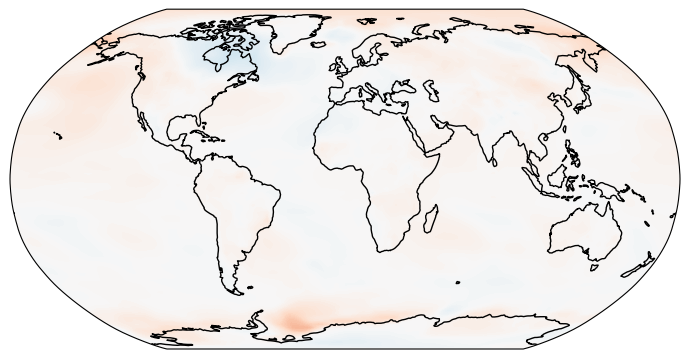

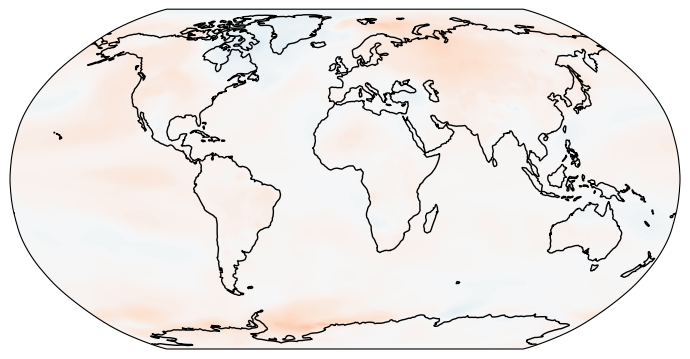

...

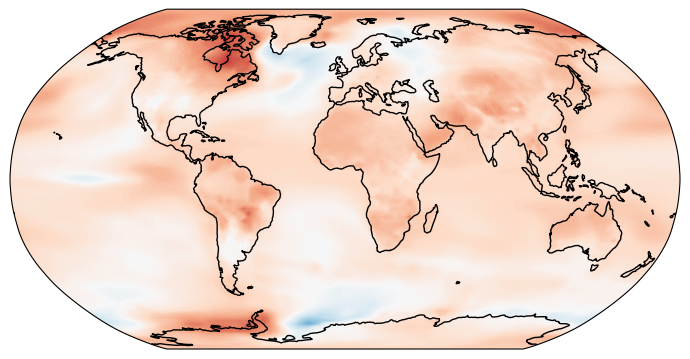

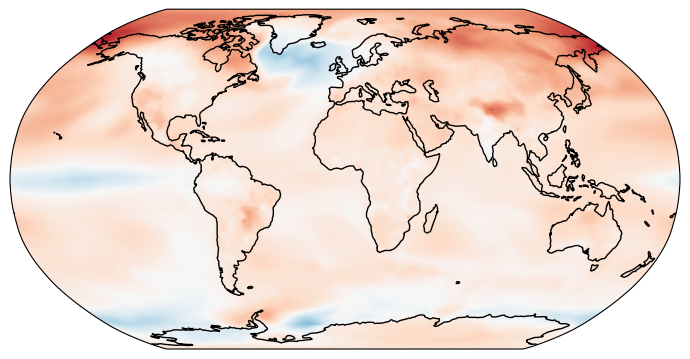

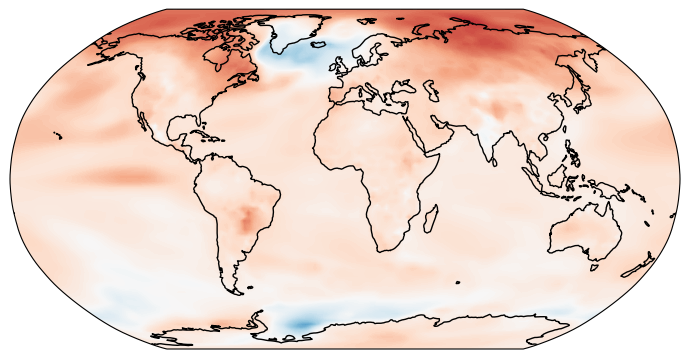

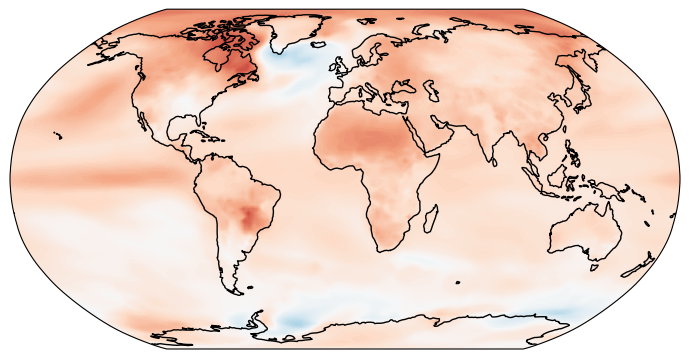

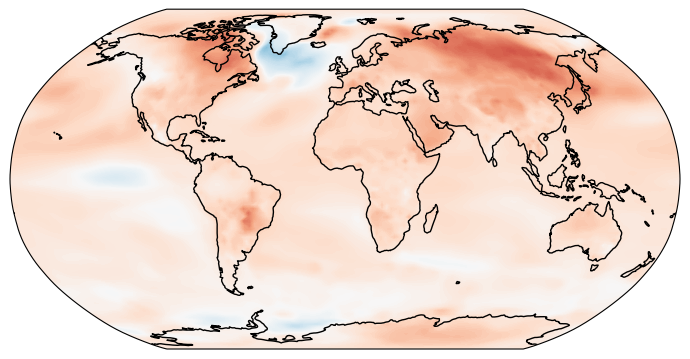

In [5]:


fig, ax = plt.subplots(1, 1, figsize=(7, 5), subplot_kw={'projection': ccrs.Robinson()})
X = tas_all.values[150,:,:]



maxX = np.max([np.max(tas_all.values), -np.min(tas_all.values)])

writer = imageio.get_writer('./gifs/warming1.gif', fps=20)


for i in range(0, 251): 
    X = tas_all.values[i,:,:]
    date = tas_all.time[i]
    fig, ax = plt.subplots(1, 1, figsize=(7, 5), subplot_kw={'projection': ccrs.Robinson()})
    fig, ax = plotmap1(X, ax, maxX)
    plt.tight_layout()
    plt.savefig('./gifs/temp.png', dpi=100)
    writer.append_data(imageio.imread('./gifs/temp.png'))

writer.close()
plt.close(fig)